<a href="https://colab.research.google.com/github/abdonasser-en/forecasting_epilepsy_seizure/blob/main/Forecasting_epilepsy_seizure.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install tqdm
!pip install plotly
!pip install lenspy # for dynamic plot and large data set
!pip install jupyter-dash -q
!pip install dash-cytoscape -
!pip install tensorflow

In [ ]:
!mkdir /content/Patient_1/train/
!mkdir  /content/Patient_1/test/

**Bibliothéques**

In [ ]:
import sys
import glob
import shutil
import scipy.io
from scipy.io import loadmat
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
from cycler import cycler
from matplotlib.collections import LineCollection
from plotly import tools
from plotly.graph_objs import Layout, YAxis, Scatter, Annotation, Annotations, Data, Figure, Marker, Font
import plotly.graph_objects as go
from jupyter_dash import JupyterDash  # pip install dash
import dash_cytoscape as cyto  # pip install dash-cytoscape==0.2.0 or higher
import dash_html_components as html
import dash_core_components as dcc
from dash.dependencies import Output, Input
import plotly.express as px
import math
from dash import no_update
from lenspy import DynamicPlot
from scipy.signal import spectrogram
from __future__ import print_function
import tensorflow as tf

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Flatten
from tensorflow.keras.layers import Conv2D, MaxPooling2D
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import save_model
from tensorflow import keras
import random

In [ ]:
# assign directory
directory = '/content/Patient_1'
directory_test='/content/Patient_1/test'
train='/content/Patient_1/train'

# iterate over files in and add the files in the correspinding files
#
for filename in glob.iglob(f'{directory}/Patient_1_interictal*'):
  shutil.move(filename,train)

for filename in glob.iglob(f'{directory}/Patient_1_preictal*'):
  shutil.move(filename,train)

for filename in glob.iglob(f'{directory}/Patient_1_test*'):
  shutil.move(filename,directory_test)


#**EDA(Exploration du dataset)**

## Checklists:



1.   **Valeur de la target**: 0 pour intercital et 1 pour preictal

2.   **Nbre de ligne et col**: pour la matrice EEG 15 ligne et 3000k Coloone
3.   **Types de variables** : 
  - Variables catégoriques: les differents types d'electrode utilisées(LD4, LD6....)
  - Variables numériques: la matrice d'EEG, la durée et la frequence d'echantillonage




In [ ]:
data= loadmat(r'/content/Patient_1/train/Patient_1_interictal_segment_0001.mat')
data1= loadmat(r'/content/Patient_1/train/Patient_1_interictal_segment_0002.mat')

In [ ]:
data

{'__header__': b'MATLAB 5.0 MAT-file, Platform: MACI64, Created on: Thu Aug 21 01:00:00 2014',
 '__version__': '1.0',
 '__globals__': [],
 'interictal_segment_1': array([[(array([[ 122,  122,  122, ...,   34,   33,   31],
                [ 641,  642,  642, ..., -385, -387, -389],
                [ 358,  358,  356, ...,  -36,  -37,  -40],
                ...,
                [ 379,  380,  379, ...,  142,  141,  140],
                [1425, 1423, 1422, ..., -809, -809, -810],
                [ 589,  590,  591, ..., -489, -490, -493]], dtype=int16), array([[600]], dtype=uint16), array([[5000]], dtype=uint16), array([[array(['LD_1'], dtype='<U4'), array(['LD_3'], dtype='<U4'),
                 array(['LD_4'], dtype='<U4'), array(['LD_5'], dtype='<U4'),
                 array(['LD_6'], dtype='<U4'), array(['LD_7'], dtype='<U4'),
                 array(['LD_8'], dtype='<U4'), array(['RD_1'], dtype='<U4'),
                 array(['RD_2'], dtype='<U4'), array(['RD_3'], dtype='<U4'),
          

In [ ]:
data=data['interictal_segment_1']

In [ ]:
#Matrice EEG
data_EEG=data[0][0][0]
data_EEG

array([[ 122,  122,  122, ...,   34,   33,   31],
       [ 641,  642,  642, ..., -385, -387, -389],
       [ 358,  358,  356, ...,  -36,  -37,  -40],
       ...,
       [ 379,  380,  379, ...,  142,  141,  140],
       [1425, 1423, 1422, ..., -809, -809, -810],
       [ 589,  590,  591, ..., -489, -490, -493]], dtype=int16)

In [ ]:
#15 lines pour les differents capteur
#3e6 million de colonnes de données pour  chaque capteur pour une durée de 600 soit 10 min
data_EEG.shape

(15, 3000000)

In [ ]:
data_time=data[0][0][1]
data_time

array([[600]], dtype=uint16)

In [ ]:
# frequence  pour chaque 1s on a 5000 de données 
data_sampling=data[0][0][2]
data_sampling

array([[5000]], dtype=uint16)

In [ ]:
num_elect=data[0][0][3]
num_elect.shape[1]

15

**Verification de la qualité de données**:
- Tous les fichiers doivent avoir la meme taille de matrice
- Il y a autant d'échantillons de données nécessaires que de secondes de données et que ces deux correspondent aux échantillons de données par secondes.



In [ ]:
def verifyData(dir_):


  search_key = "_segment_"       # search key string

  for filename in glob.iglob(f'{dir_}/Patient_1_*') : #etiher precital or interictal
          try:
              segment_dict = loadmat(filename)        # loads the .mat file as a dictionary
              segment = dict(filter(lambda item: search_key in item[0], segment_dict.items()))  # retrieves only the item which contain the data of interes
              segment_list_of_values = list(segment.values())
              total_num_dataSamples = np.array(segment_list_of_values[0][0][0][0].shape[1], dtype=float) #30000000 de donneées
              total_num_rowdata=np.array(segment_list_of_values[0][0][0][0].shape[0], dtype=int) # 15 row means 15 means
              datarows_duration_secs = np.array(segment_list_of_values[0][0][0][1], dtype=float) #600s
              datasamples_perSecond = np.array(segment_list_of_values[0][0][0][2], dtype=float) #5000 data per s
              number_of_electrode=np.array(segment_list_of_values[0][0][0][3].shape[1], dtype=int) # 15

              if total_num_dataSamples != np.around((datarows_duration_secs * datasamples_perSecond)): #600s*5000/s=300000000
                  print("Manque de données dans ce fichier : %s" % filename)
              if total_num_rowdata!=number_of_electrode:
                print("Manque d'une matrice EEG :dans ce fichier %s" % filename) #if 15 == 15
          except:
              e = sys.exc_info()[0]
              print("une exception %s trouvé dans ce fichier%s " %  filename)
              break

  print("Verification terminé avec succés.")

**Cette fonction vérifie dans chaque tableau il y a 3e6 de données et que le nombre d'electrodes est egale au nombre de ligne de la matrice EEF**

In [ ]:
train='/content/Patient_1/train'
verifyData(train)

Verification terminé avec succés.


In [ ]:
test='/content/Patient_1/test'
verifyData(test)

Verification terminé avec succés.


**Visualisation et analyse de données**

- Aide visualisation: https://matplotlib.org/3.3.1/gallery/specialty_plots/mri_with_eeg.html



In [ ]:
def visualisation(data):

    search_key = '_segment_'
    segment = dict(filter(lambda item: search_key in item[0], data.items()))
    segment = list(segment.values())
    data_EEG = segment[0][0][0][0]
    num_electrodes = data_EEG.shape[0]             # rows (i.e. electrodes) in the data matrix
    n_samples = data_EEG.shape[1]                  # number of samples on each row (i.e. electrode's samples)
    electrode_names = segment[0][0][0][3][0]   # name or labels of the electrodes
    t = 10 * np.arange(n_samples) / n_samples

    # create the 'figure'
    fig = plt.figure("EEG samples",figsize=(30,15))

    ticklocs = []
    ax = fig.add_subplot(1, 1, 1)
    ax.set_xlim(0, 10)
    ax.set_xticks(np.arange(10))
    data_min = data_EEG.min()
    data_max = data_EEG.max()
    dr = (data_max - data_min) * 1.5   #crowd it a bit
    y0 = data_min
    y1 = (num_electrodes -1) * dr + data_max
    ax.set_ylim(y0, y1)

    segs = []
    for electrode in range(num_electrodes):
        segs.append(np.column_stack((t, data_EEG[electrode, :])))
        ticklocs.append(electrode * dr)
        
    offsets = np.zeros((num_electrodes, 2), dtype=float)
    offsets[:, 1] = ticklocs

    lines = LineCollection(segs, offsets=offsets, transOffset=None)
    ax.add_collection(lines)

    # Set the yticks to use axes coordinates on the y axis
    ax.set_yticks(ticklocs)
    ax.set_yticklabels(electrode_names)

    ax.set_xlabel('Time (minutes)')

    plt.show()

**Explication de la fonction de visualisation de données**

In [ ]:
visu_test=loadmat(r'/content/Patient_1/train/Patient_1_interictal_segment_0001.mat')
search_key = '_segment_'
segment = dict(filter(lambda item: '_segment_' in item[0], visu_test.items()))
y=list(segment.values())
print(y[0][0][0][0])



[[ 122  122  122 ...   34   33   31]
 [ 641  642  642 ... -385 -387 -389]
 [ 358  358  356 ...  -36  -37  -40]
 ...
 [ 379  380  379 ...  142  141  140]
 [1425 1423 1422 ... -809 -809 -810]
 [ 589  590  591 ... -489 -490 -493]]


In [ ]:
y[0][0][0][0].shape[0]

15

In [ ]:
y[0][0][0][0].shape[1]

3000000

In [ ]:
i=np.arange(6)
i

array([0, 1, 2, 3, 4, 5])

In [ ]:
# c'est pour afficher le temps pour chaque données dans une ligne 
t=10 * np.arange(y[0][0][0][0].shape[1]) / y[0][0][0][0].shape[1]
t.shape


(3000000,)

In [ ]:
data_min = y[0][0][0][0].min()
data_max = y[0][0][0][0].max()
dr = (data_max - data_min) * 0.7   #crowd it a bit
y0 = data_min
y1 = (y[0][0][0][0].shape[0] -1) * dr + data_max
print(data_min,data_max,dr,y0,y1,t.shape)


-1142 3572 3299.7999999999997 -1142 49769.2 (3000000,)


In [ ]:
ticklocs=[]
segs = []
for electrode in range(y[0][0][0][0].shape[0]):
    segs.append(np.column_stack((t, y[0][0][0][0][electrode, :])))
    ticklocs.append(electrode * dr)

offsets = np.zeros((15, 2), dtype=float)
offsets[:, 1] = ticklocs
print(offsets)

[[    0.      0. ]
 [    0.   3299.8]
 [    0.   6599.6]
 [    0.   9899.4]
 [    0.  13199.2]
 [    0.  16499. ]
 [    0.  19798.8]
 [    0.  23098.6]
 [    0.  26398.4]
 [    0.  29698.2]
 [    0.  32998. ]
 [    0.  36297.8]
 [    0.  39597.6]
 [    0.  42897.4]
 [    0.  46197.2]]


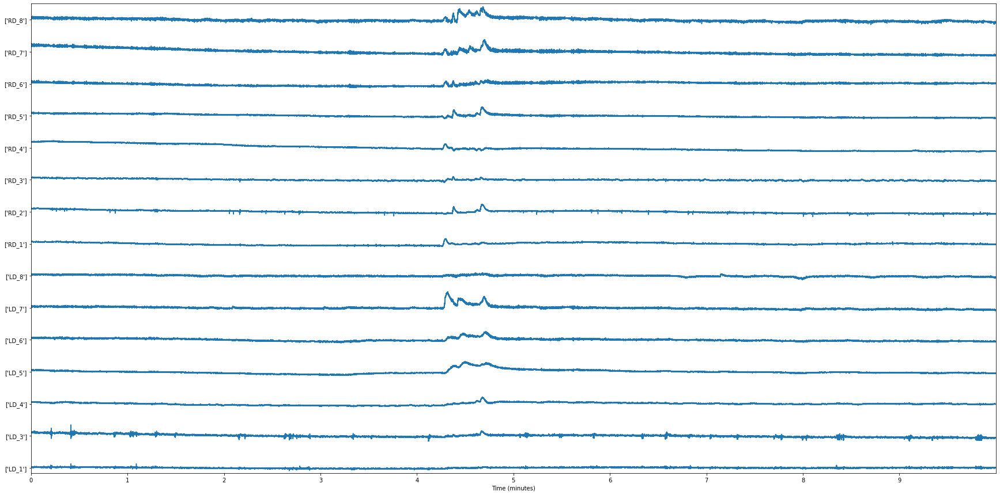

In [ ]:
visualisation(visu_test)

**La Fonction visualisation nous permet de visualiser chaque segement pour chaque capteur electrode sur 10 min**

In [ ]:
test0=loadmat(r'/content/Patient_1/train/Patient_1_interictal_segment_0001.mat')
test1=loadmat(r'/content/Patient_1/train/Patient_1_preictal_segment_0001.mat') 
test2=loadmat(r'/content/Patient_1/train/Patient_1_interictal_segment_0002.mat')
test3=loadmat(r'/content/Patient_1/train/Patient_1_preictal_segment_0002.mat')
test4=loadmat(r'/content/Patient_1/train/Patient_1_interictal_segment_0003.mat')
test5=loadmat(r'/content/Patient_1/train/Patient_1_preictal_segment_0003.mat')

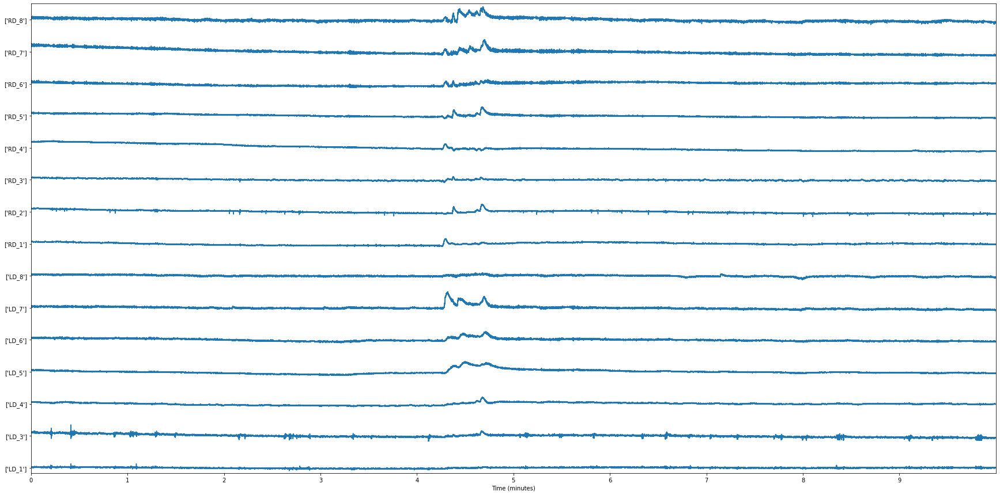

In [ ]:
visualisation(test0)

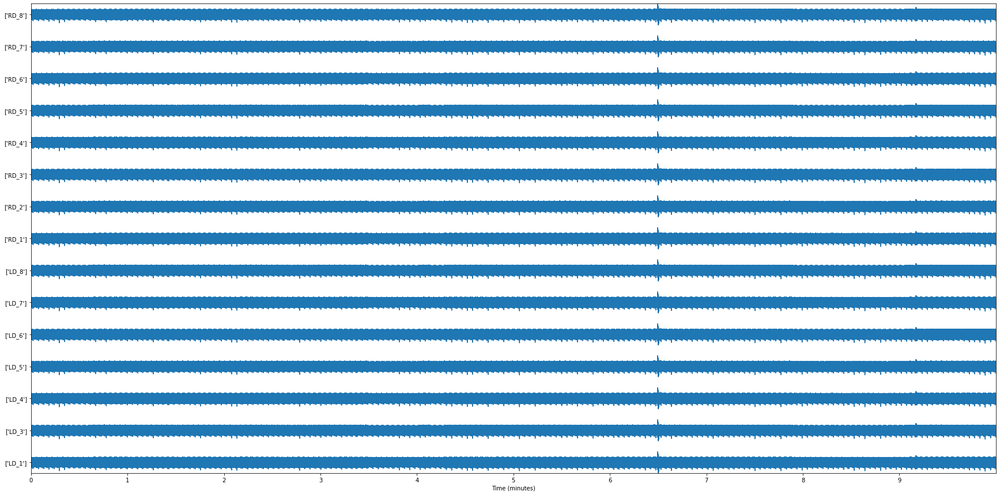

In [ ]:
visualisation(test1)

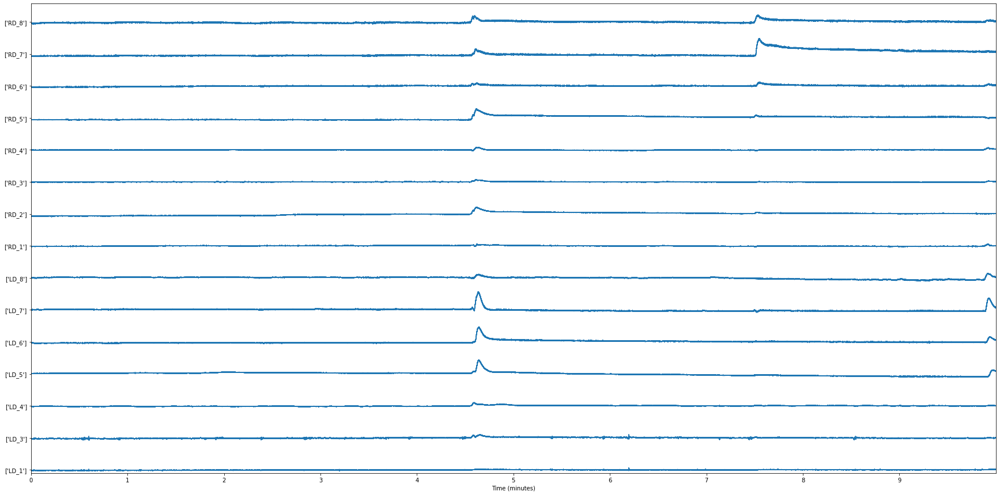

In [ ]:
visualisation(test2)

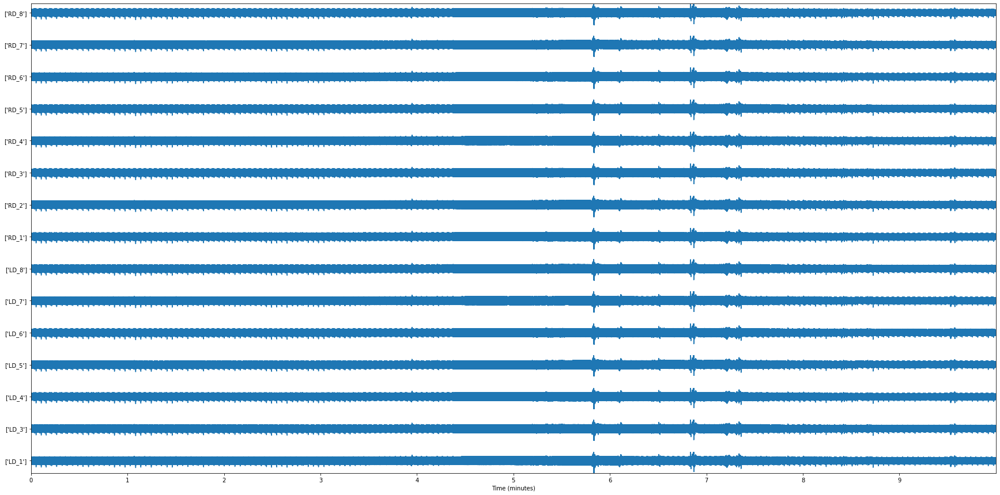

In [ ]:
visualisation(test3)

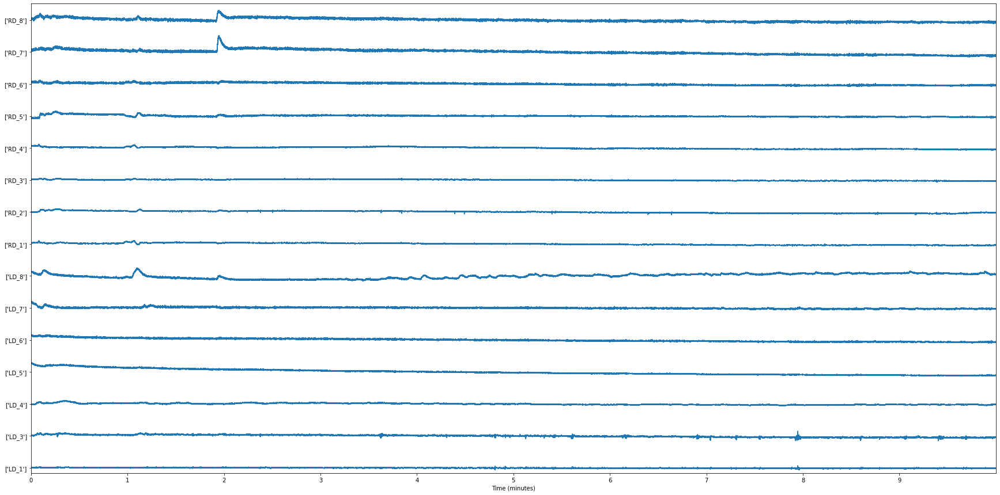

In [ ]:
visualisation(test4)

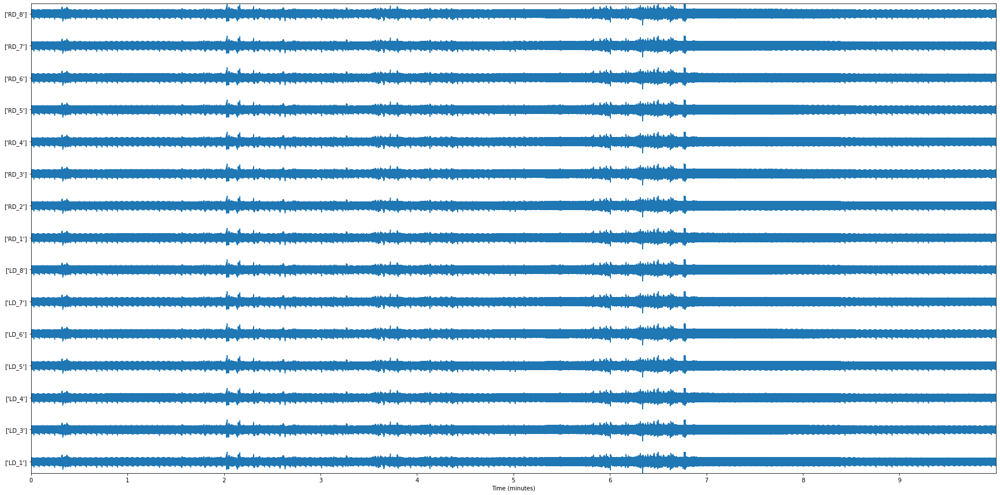

In [ ]:
visualisation(test5)

Interictal


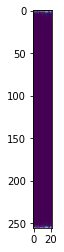

Preictal


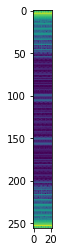

Interictal


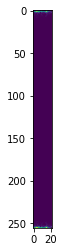

Preictal


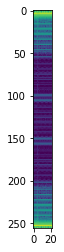

In [ ]:
interictal_array=test0['interictal_segment_1'][0][0][0]
preictal_array=test1['preictal_segment_1'][0][0][0]

l = list(range(10000))
for i in l[::5000]:
    print('Interictal')
    i_secs = interictal_array[0][i:i+5000]
    i_f, i_t, i_Sxx = spectrogram(i_secs, fs=5000, return_onesided=False)
    i_SS = np.log1p(i_Sxx)
    plt.imshow(i_SS[:] / np.max(i_SS))
    plt.show()
    print('Preictal')
    p_secs = preictal_array[0][i:i+5000]
    p_f, p_t, p_Sxx = spectrogram(p_secs, fs=5000, return_onesided=False)
    p_SS = np.log1p(p_Sxx)
    plt.imshow(p_SS[:] / np.max(p_SS))
    plt.show()

In [ ]:
def plotSpectograms(file, electrode=0):
    search_key = "_segment_"       # search key string
    file=loadmat(file)
    segment = dict(filter(lambda item: search_key in item[0], file.items()))
    segment_list_values = list(segment.values())

    x = np.array(segment_list_values[0][0][0][0][electrode], dtype=float)
    secs = np.array(segment_list_values[0][0][0][1], dtype=float)
    Fs = np.array(segment_list_values[0][0][0][2], dtype=float)[0][0]
    NFFT = 1024  # the length of the windowing segments
    dt = 1/Fs
    t = np.arange(0.0, 600.0, dt)

    fig, (ax1, ax2) = plt.subplots(nrows=2, figsize=(15,10))
    ax1.plot(t, x)
    ax1.set_xlabel('Time (s)')
    ax1.set_ylabel('EEG Data')
    Pxx, freqs, bins, im = ax2.specgram(x, NFFT=NFFT, Fs=Fs, noverlap=100, sides='twosided')
    ax2.set_xlabel('Time (s) spectrogramm')
    ax2.set_ylabel('EEG Data spectrogramm')

    plt.suptitle(f'{list(file.keys())[-1]} ')
    # The `specgram` method returns 4 objects. They are:
    # - Pxx: the periodogram
    # - freqs: the frequency vector
    # - bins: the centers of the time bins
    # - im: the .image.AxesImage instance representing the data in the plot
    

    plt.show()

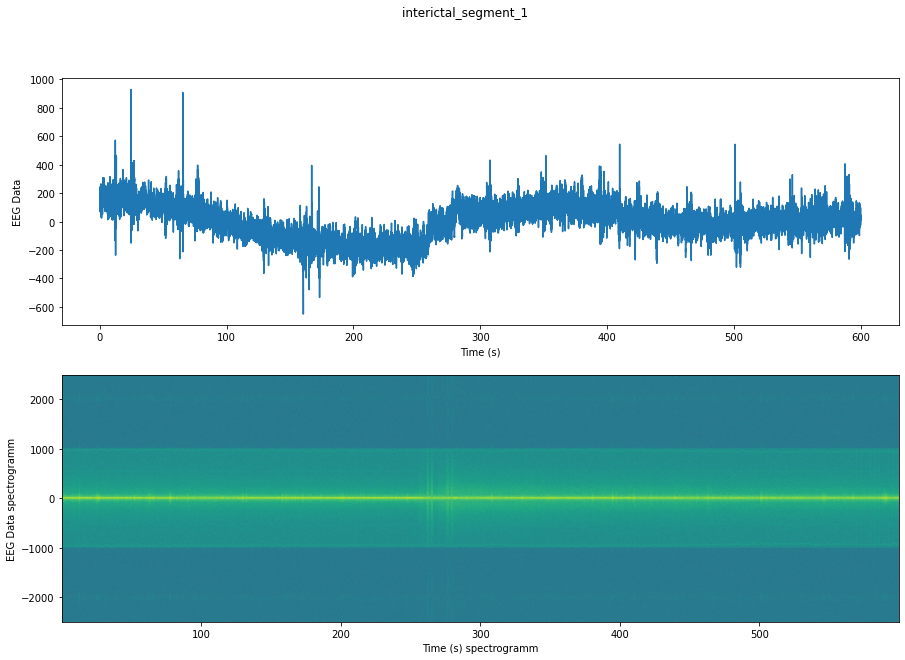

In [ ]:
plotSpectograms(test0)

**Trier de maniere ascendant tous les chemins d'accés de filname**

In [ ]:
def file_sorted_forplot(dir):
  tab=sorted([filename for filename in glob.iglob(f'{dir}/Patient_1_*')])
  return tab

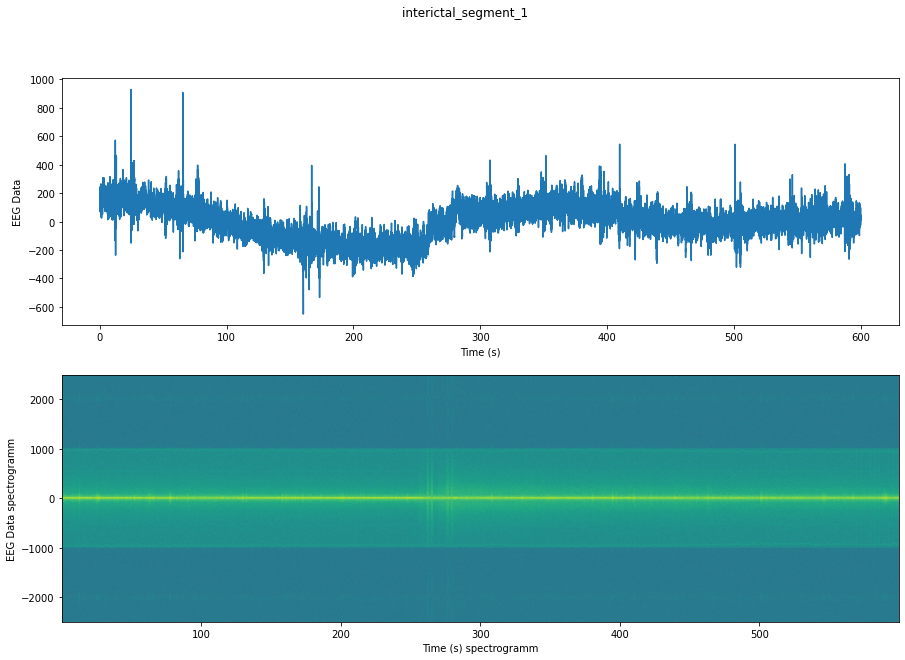

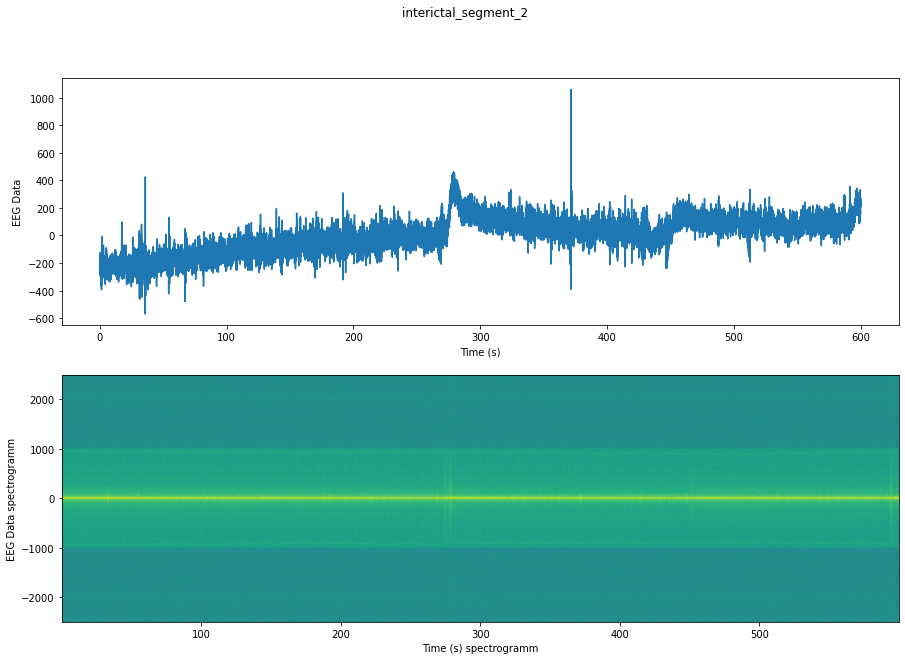

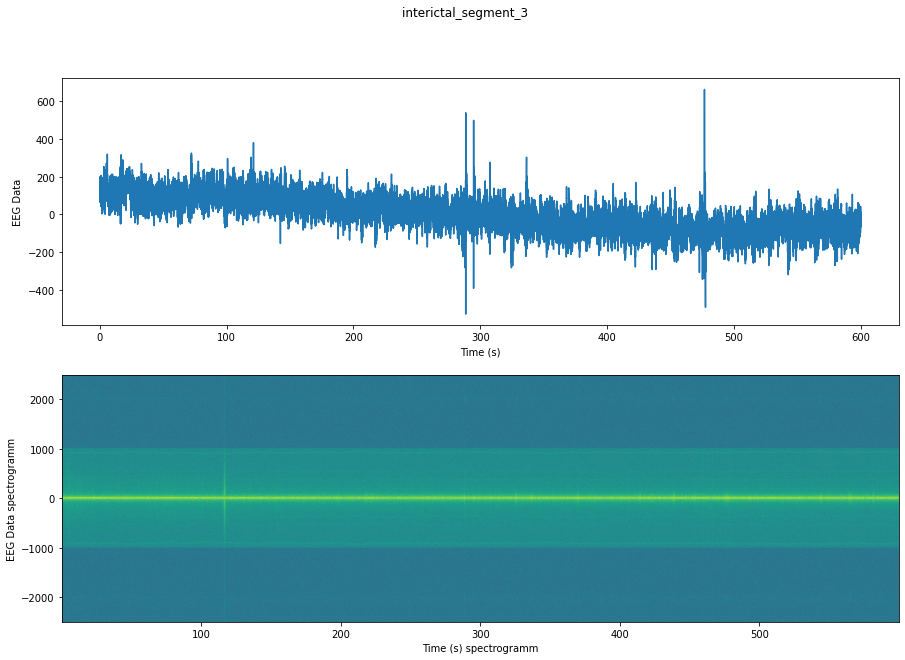

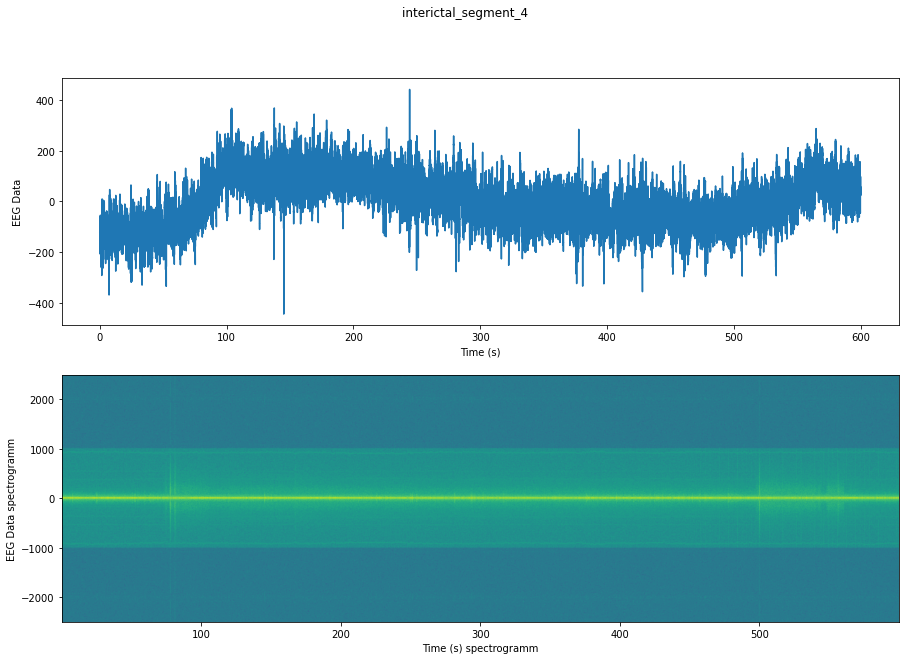

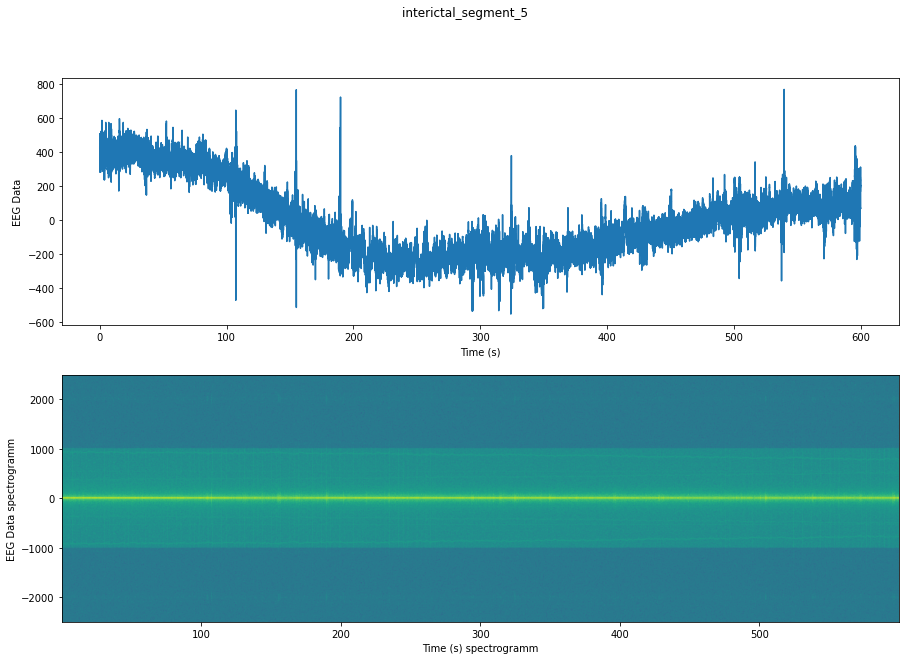

...

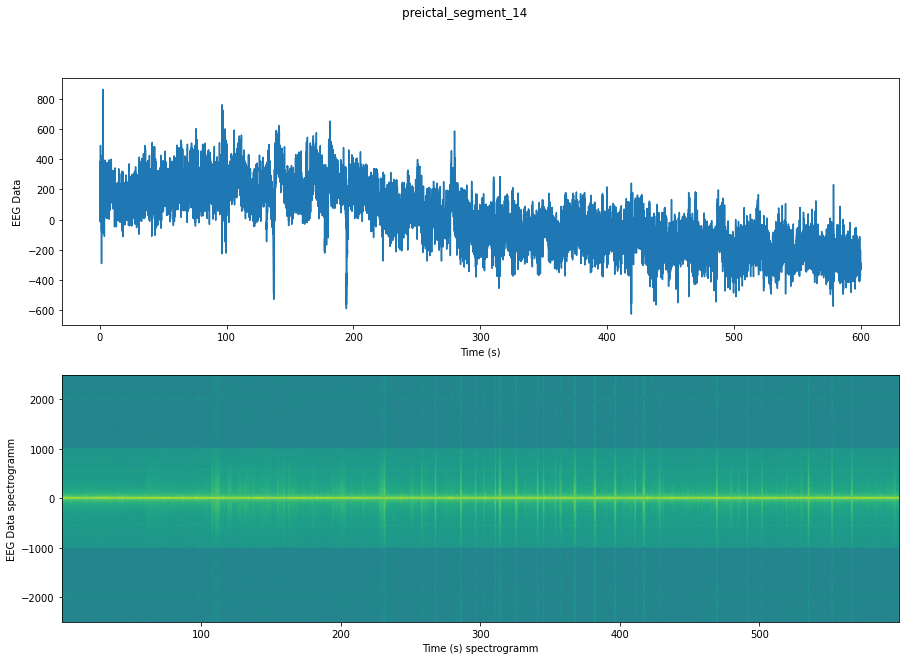

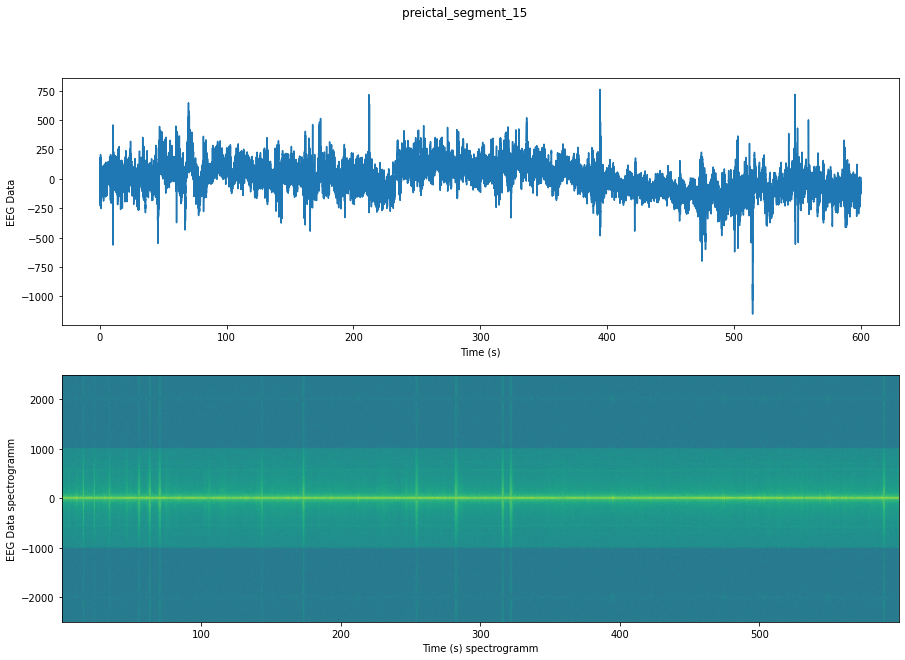

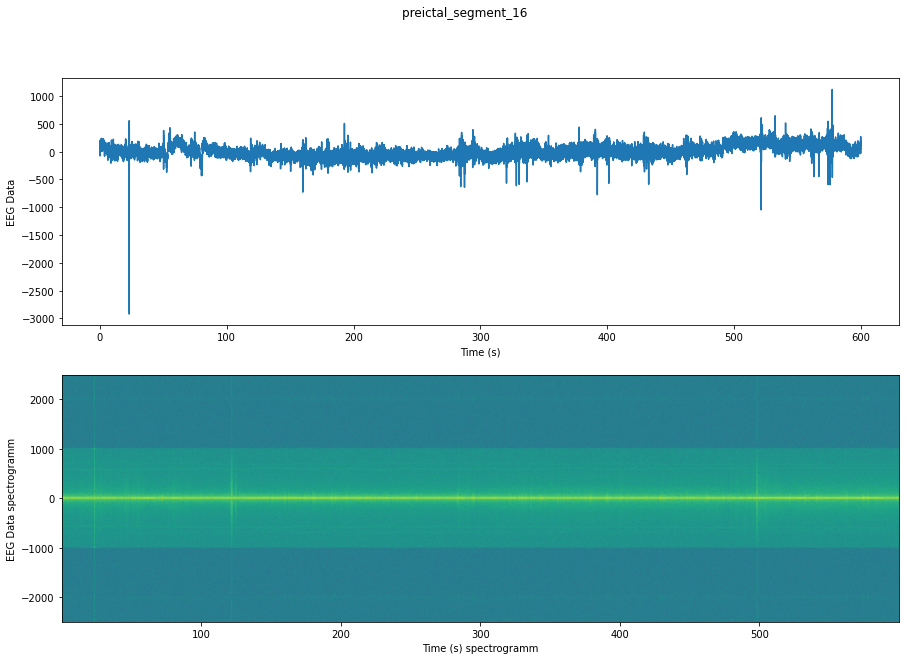

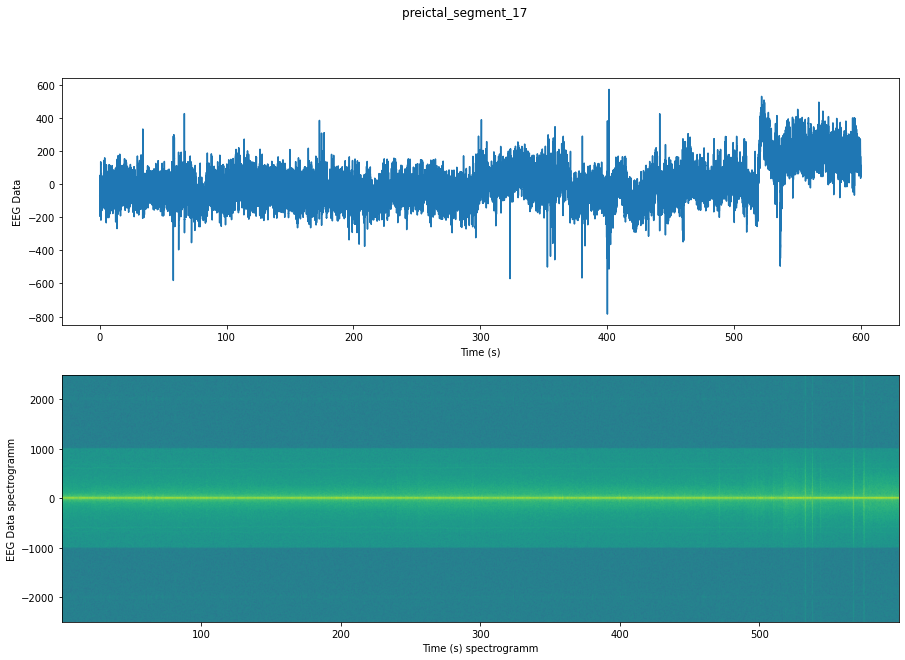

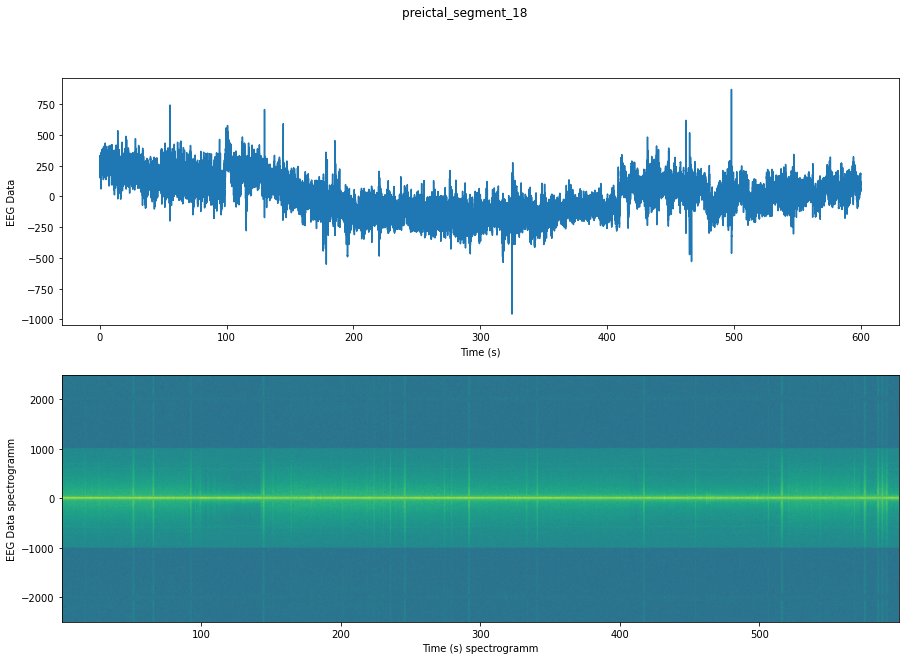

In [ ]:
dir='/content/Patient_1/train'
table_plot=file_sorted_forplot(dir)
for filename in table_plot:
  plotSpectograms(filename)

In [ ]:
def file_sorted_formodel(dir,types):
  tab=sorted([filename for filename in glob.iglob(f'{dir}/Patient_1_{types}*')])
  return tab

In [ ]:
tab1=file_sorted_formodel('/content/Patient_1/train','interictal')
tab2=file_sorted_formodel('/content/Patient_1/train','preictal')

In [ ]:
print(len(tab1),len(tab2))

50 18


In [ ]:
tab1=tab1[:18]
tab1

['/content/Patient_1/train/Patient_1_interictal_segment_0001.mat',
 '/content/Patient_1/train/Patient_1_interictal_segment_0002.mat',
 '/content/Patient_1/train/Patient_1_interictal_segment_0003.mat',
 '/content/Patient_1/train/Patient_1_interictal_segment_0004.mat',
 '/content/Patient_1/train/Patient_1_interictal_segment_0005.mat',
 '/content/Patient_1/train/Patient_1_interictal_segment_0006.mat',
 '/content/Patient_1/train/Patient_1_interictal_segment_0007.mat',
 '/content/Patient_1/train/Patient_1_interictal_segment_0008.mat',
 '/content/Patient_1/train/Patient_1_interictal_segment_0009.mat',
 '/content/Patient_1/train/Patient_1_interictal_segment_0010.mat',
 '/content/Patient_1/train/Patient_1_interictal_segment_0011.mat',
 '/content/Patient_1/train/Patient_1_interictal_segment_0012.mat',
 '/content/Patient_1/train/Patient_1_interictal_segment_0013.mat',
 '/content/Patient_1/train/Patient_1_interictal_segment_0014.mat',
 '/content/Patient_1/train/Patient_1_interictal_segment_0015.m

In [ ]:
tab2

['/content/Patient_1/train/Patient_1_preictal_segment_0001.mat',
 '/content/Patient_1/train/Patient_1_preictal_segment_0002.mat',
 '/content/Patient_1/train/Patient_1_preictal_segment_0003.mat',
 '/content/Patient_1/train/Patient_1_preictal_segment_0004.mat',
 '/content/Patient_1/train/Patient_1_preictal_segment_0005.mat',
 '/content/Patient_1/train/Patient_1_preictal_segment_0006.mat',
 '/content/Patient_1/train/Patient_1_preictal_segment_0007.mat',
 '/content/Patient_1/train/Patient_1_preictal_segment_0008.mat',
 '/content/Patient_1/train/Patient_1_preictal_segment_0009.mat',
 '/content/Patient_1/train/Patient_1_preictal_segment_0010.mat',
 '/content/Patient_1/train/Patient_1_preictal_segment_0011.mat',
 '/content/Patient_1/train/Patient_1_preictal_segment_0012.mat',
 '/content/Patient_1/train/Patient_1_preictal_segment_0013.mat',
 '/content/Patient_1/train/Patient_1_preictal_segment_0014.mat',
 '/content/Patient_1/train/Patient_1_preictal_segment_0015.mat',
 '/content/Patient_1/trai

In [ ]:
tab=[tab1,tab2]
tab

[['/content/Patient_1/train/Patient_1_interictal_segment_0001.mat',
  '/content/Patient_1/train/Patient_1_interictal_segment_0002.mat',
  '/content/Patient_1/train/Patient_1_interictal_segment_0003.mat',
  '/content/Patient_1/train/Patient_1_interictal_segment_0004.mat',
  '/content/Patient_1/train/Patient_1_interictal_segment_0005.mat',
  '/content/Patient_1/train/Patient_1_interictal_segment_0006.mat',
  '/content/Patient_1/train/Patient_1_interictal_segment_0007.mat',
  '/content/Patient_1/train/Patient_1_interictal_segment_0008.mat',
  '/content/Patient_1/train/Patient_1_interictal_segment_0009.mat',
  '/content/Patient_1/train/Patient_1_interictal_segment_0010.mat',
  '/content/Patient_1/train/Patient_1_interictal_segment_0011.mat',
  '/content/Patient_1/train/Patient_1_interictal_segment_0012.mat',
  '/content/Patient_1/train/Patient_1_interictal_segment_0013.mat',
  '/content/Patient_1/train/Patient_1_interictal_segment_0014.mat',
  '/content/Patient_1/train/Patient_1_interictal

In [ ]:
X=[]
y=[]

for i, table in enumerate(tab):

  for j in table:
    data=loadmat(j)
    search_key = '_segment_'
    segment = dict(filter(lambda item: search_key in item[0], data.items()))
    segment = list(segment.values())
    EEG_spec=segment[0][0][0][0][0]
    lst = list(range(3000000))  # 10 minutes

    for u in lst[::5000]:
      data_secs = EEG_spec[u:u+5000]
      data_f, data_t, data_Sxx = spectrogram(data_secs, fs=5000, return_onesided=False)
      data_SS = np.log1p(data_Sxx)
      arr = data_SS[:] / np.max(data_SS)
      X.append(arr)
      y.append(i)


In [ ]:
X

[array([[0.02899724, 0.0062881 , 0.06839422, ..., 0.03464483, 0.09693129,
         0.00306615],
        [0.4643937 , 0.52776164, 0.54667634, ..., 0.47127643, 1.        ,
         0.2945521 ],
        [0.28736165, 0.00766578, 0.21097118, ..., 0.02846911, 0.49801478,
         0.12542816],
        ...,
        [0.0061399 , 0.00248675, 0.1445471 , ..., 0.02388739, 0.09455094,
         0.03942537],
        [0.28736165, 0.00766578, 0.21097118, ..., 0.02846911, 0.49801478,
         0.12542816],
        [0.4643937 , 0.52776164, 0.54667634, ..., 0.47127643, 1.        ,
         0.2945521 ]], dtype=float32),
 array([[0.03918279, 0.00357427, 0.07557857, ..., 0.07785264, 0.00075377,
         0.00534553],
        [0.41053298, 0.59406006, 0.65760833, ..., 0.33113575, 0.08773148,
         0.0165004 ],
        [0.18611954, 0.13598894, 0.23081437, ..., 0.00212469, 0.1405843 ,
         0.17280248],
        ...,
        [0.01071496, 0.03457057, 0.09449648, ..., 0.02627997, 0.02670567,
         0.01718424

In [ ]:
img_rows, img_cols=256,22

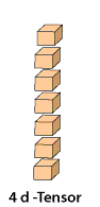

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=True)

In [ ]:
X_train=np.array(X_train)
X_test=np.array(X_test)
X_train=X_train.reshape(len(X_train),img_rows, img_cols, 1)
X_test = X_test.reshape(len(X_test), img_rows, img_cols, 1)
X_train = X_train.astype('float32')
X_test = X_test.astype('float32')

In [ ]:
y_train=tuple(y_train)
y_test=tuple(y_test)
len(X_train)
# len(y_train)

17280

In [ ]:
batch_size = 128
num_classes = 2
epochs = 30
input_shape = (img_rows, img_cols, 1)

In [ ]:
#categorise y en 0 et 1
y_train = tf.keras.utils.to_categorical(y_train, num_classes) 
y_test = tf.keras.utils.to_categorical(y_test, num_classes)
len(y_test)

4320

In [ ]:
model = Sequential()

model.add(Conv2D(32, kernel_size=(5, 5),
                 activation='relu',
                 input_shape=input_shape))
model.add(Conv2D(32, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.25))
model.add(Flatten())
model.add(Dense(32, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(num_classes, activation='sigmoid'))

model.compile(loss=tf.keras.losses.binary_crossentropy,
              optimizer=tf.keras.optimizers.RMSprop(),
              metrics=['accuracy'])

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 252, 18, 32)       832       
                                                                 
 conv2d_1 (Conv2D)           (None, 250, 16, 32)       9248      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 125, 8, 32)       0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 125, 8, 32)        0         
                                                                 
 flatten (Flatten)           (None, 32000)             0         
                                                                 
 dense (Dense)               (None, 32)                1024032   
                                                        

In [ ]:
model.fit(X_train, y_train,
          batch_size=batch_size,
          epochs=epochs,
          verbose=1,
          validation_data=(X_test, y_test))
score = model.evaluate(X_test, y_test, verbose=0)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

Epoch 1/30
135/135 [==============================] - 212s 2s/step - loss: 0.5068 - accuracy: 0.6508 - val_loss: 0.4710 - val_accuracy: 0.6576
Epoch 2/30
135/135 [==============================] - 214s 2s/step - loss: 0.4871 - accuracy: 0.6604 - val_loss: 0.4685 - val_accuracy: 0.6609
Epoch 3/30
135/135 [==============================] - 213s 2s/step - loss: 0.4858 - accuracy: 0.6649 - val_loss: 0.4668 - val_accuracy: 0.6799
Epoch 4/30
135/135 [==============================] - 214s 2s/step - loss: 0.4827 - accuracy: 0.6703 - val_loss: 0.4691 - val_accuracy: 0.6588
Epoch 5/30
135/135 [==============================] - 219s 2s/step - loss: 0.4796 - accuracy: 0.6725 - val_loss: 0.4636 - val_accuracy: 0.7044
Epoch 6/30
135/135 [==============================] - 217s 2s/step - loss: 0.4735 - accuracy: 0.6830 - val_loss: 0.4641 - val_accuracy: 0.6766
Epoch 7/30
135/135 [==============================] - 215s 2s/step - loss: 0.4726 - accuracy: 0.6926 - val_loss: 0.4556 - val_accuracy: 0.7072

In [ ]:
# from tensorflow.keras.models import save_model
# save_model(model, "model.h5")

In [ ]:
def predic_check_file(dir):
    X=[]
    img_rows, img_cols = 256, 22
    dir=file_sorted_formodel(dir_init,'test')
    dir_idx = random.randrange(len(dir))   # ces 3 morceaux de code permet de choisir au hasart un fichier de test
    dir = dir[dir_idx]
    data=loadmat(dir)
    search_key = '_segment_'
    segment = dict(filter(lambda item: search_key in item[0], data.items()))
    key_name=list(segment.items())
    key_name=key_name[0][0]
    segment = list(segment.values())
    EEG_spec=segment[0][0][0][0][0]
    lst = list(range(3000000))  # 10 minutes

    for i in lst[::5000]:
      data_secs = EEG_spec[i:i+5000]
      data_f, data_t, data_Sxx = spectrogram(data_secs, fs=5000, return_onesided=False)
      data_SS = np.log1p(data_Sxx)
      arr = data_SS[:] / np.max(data_SS)
      X.append(arr)
    X=np.array(X)
    X=X.reshape(len(X),img_rows, img_cols, 1) #un tensor
    print(f'ce fichier test est pour le segement{key_name}')
    return X



In [ ]:
dir_init='/content/Patient_1/test'
dir=file_sorted_formodel(dir_init,'test')
dir_idx = random.randrange(len(dir))
dir = dir[dir_idx]
dir
test_predict=loadmat(dir)
test_predict

{'__header__': b'MATLAB 5.0 MAT-file, Platform: MACI64, Created on: Thu Aug 21 01:00:00 2014',
 '__version__': '1.0',
 '__globals__': [],
 'test_segment_144': array([[(array([[ 137,  139,  142, ...,  121,  120,  119],
                [-188, -185, -178, ...,  308,  305,  304],
                [ 380,  379,  380, ...,  -65,  -66,  -66],
                ...,
                [ 432,  432,  433, ..., -117, -118, -119],
                [ 396,  395,  395, ..., -254, -255, -256],
                [-131, -130, -129, ...,  -16,  -17,  -17]], dtype=int16), array([[600]], dtype=uint16), array([[5000]], dtype=uint16), array([[array(['LD_1'], dtype='<U4'), array(['LD_3'], dtype='<U4'),
                 array(['LD_4'], dtype='<U4'), array(['LD_5'], dtype='<U4'),
                 array(['LD_6'], dtype='<U4'), array(['LD_7'], dtype='<U4'),
                 array(['LD_8'], dtype='<U4'), array(['RD_1'], dtype='<U4'),
                 array(['RD_2'], dtype='<U4'), array(['RD_3'], dtype='<U4'),
              

In [ ]:
dir_init='/content/Patient_1/test'
X=predic_check_file(dir_init)

ce fichier test est pour le segementtest_segment_119


In [ ]:
model_test=keras.models.load_model("/content/model.h5")
y=model_test.predict(X)
d=np.argmax(y,axis=1)
print(d)

count_arr = np.bincount(d)

print(count_arr[0])
print(count_arr[1])

19/19 [==============================] - 2s 88ms/step
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 0 1 1 1 0 1 1 1 1 1 1 1
 0 1 1 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 0 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1

In [ ]:
probability_model = tf.keras.Sequential([model_test, 
                                         tf.keras.layers.Softmax()])
predictions = probability_model.predict(X)
predictions

19/19 [==============================] - 2s 88ms/step


array([[0.28699484, 0.71300524],
       [0.4324895 , 0.5675105 ],
       [0.28732628, 0.7126737 ],
       ...,
       [0.28137448, 0.7186255 ],
       [0.2692726 , 0.7307274 ],
       [0.2723763 , 0.72762376]], dtype=float32)

In [ ]:
np.argmax(predictions,axis=1)

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0,
       1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,